In [1]:
import os
os.sys.path.append("C:\\Users\mplitt\MightyMorphingPhotonRangers")
import numpy as np
import matplotlib.pyplot as plt
import utilities as u
import preprocessing as pp
import behavior as b
import SimilarityMatrixAnalysis as sm
import scipy as sp
import PlaceCellAnalysis as pc


%load_ext autoreload
%autoreload 2

%matplotlib inline

In [57]:
mouse = '4139265.3'
df = pp.load_session_db()


df = df[df['RewardCount']>30]
df = df[df['Imaging']==1]
df = df.sort_values(['MouseName','DateTime','SessionNumber'])
tracks = 'TwoTower_noTimeout|TwoTower_Timeout|Reversal_noTimeout|Reversal|TwoTower_foraging'
df = df[df['Track'].str.contains(tracks,regex=True)]

df_mouse = df[df['MouseName'].str.match(mouse)]
# df_mouse = df_mouse[df_mouse['Track'].str.match('TwoTower_noTimeout') | df_mouse['Track'].str.match('TwoTower_Timeout')]
df_mouse

G:\My Drive\VR_Data\TwoTower\behavior.sqlite


,MouseName,DateFolder,SessionNumber,Track,RewardCount,Imaging,ImagingRegion,DateTime,data file,scanfile,scanmat,s2pfolder
1403,4139265.3,10_02_2019,1,TwoTower_foraging,60,1,CA1,2019-02-10,G:\My Drive\VR_Data\TwoTower\4139265.3\10_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\10_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\10_02_2...
1405,4139265.3,10_02_2019,3,TwoTower_foraging,60,1,CA1,2019-02-10,G:\My Drive\VR_Data\TwoTower\4139265.3\10_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\10_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\10_02_2...
1433,4139265.3,12_02_2019,2,TwoTower_foraging,90,1,CA1,2019-02-12,G:\My Drive\VR_Data\TwoTower\4139265.3\12_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\12_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\12_02_2...
1455,4139265.3,15_02_2019,4,TwoTower_foraging,72,1,CA1,2019-02-15,G:\My Drive\VR_Data\TwoTower\4139265.3\15_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\15_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\15_02_2...
1475,4139265.3,17_02_2019,2,TwoTower_foraging,81,1,CA1,2019-02-17,G:\My Drive\VR_Data\TwoTower\4139265.3\17_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\17_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\17_02_2...
1495,4139265.3,19_02_2019,2,TwoTower_foraging,92,1,CA1,2019-02-19,G:\My Drive\VR_Data\TwoTower\4139265.3\19_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\19_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\19_02_2...
1513,4139265.3,21_02_2019,2,TwoTower_foraging,90,1,CA1,2019-02-21,G:\My Drive\VR_Data\TwoTower\4139265.3\21_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\21_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\21_02_2...
1522,4139265.3,22_02_2019,2,TwoTower_foraging,90,1,CA1,2019-02-22,G:\My Drive\VR_Data\TwoTower\4139265.3\22_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\22_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\22_02_2...
1531,4139265.3,23_02_2019,2,TwoTower_foraging,93,1,CA1,2019-02-23,G:\My Drive\VR_Data\TwoTower\4139265.3\23_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\23_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\23_02_2...
1537,4139265.3,24_02_2019,2,TwoTower_foraging,97,1,CA1,2019-02-24,G:\My Drive\VR_Data\TwoTower\4139265.3\24_02_2...,None,G:\My Drive\2P_Data\TwoTower\4139265.3\24_02_2...,G:\My Drive\2P_Data\TwoTower\4139265.3\24_02_2...


In [58]:
sess = df_mouse.iloc[-1]
print(sess['data file'])

G:\My Drive\VR_Data\TwoTower\4139265.3\24_02_2019\TwoTower_foraging_2.sqlite


In [89]:
print(sess)

MouseName                                                4139265.3
DateFolder                                              24_02_2019
SessionNumber                                                    2
Track                                            TwoTower_foraging
RewardCount                                                     97
Imaging                                                          1
ImagingRegion                                                  CA1
DateTime                                       2019-02-24 00:00:00
data file        G:\My Drive\VR_Data\TwoTower\4139265.3\24_02_2...
scanfile                                                      None
scanmat          G:\My Drive\2P_Data\TwoTower\4139265.3\24_02_2...
s2pfolder        G:\My Drive\2P_Data\TwoTower\4139265.3\24_02_2...
Name: 1537, dtype: object


num aberrant ttls 0.0
32038 (32038,) (32038, 21) 105022


C:\Users\mplitt\Anaconda3\lib\site-packages\pandas\core\frame.py:4034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  downcast=downcast, **kwargs)


frame diff 0
start bootstrap
end bootstrap
start bootstrap
end bootstrap
start bootstrap
end bootstrap
start bootstrap
end bootstrap
start bootstrap
end bootstrap
morph 0 place cells = 1017 out of 1634 , 0.622399 
morph 1 place cells = 1034 out of 1634, 0.632803
common place cells = 666


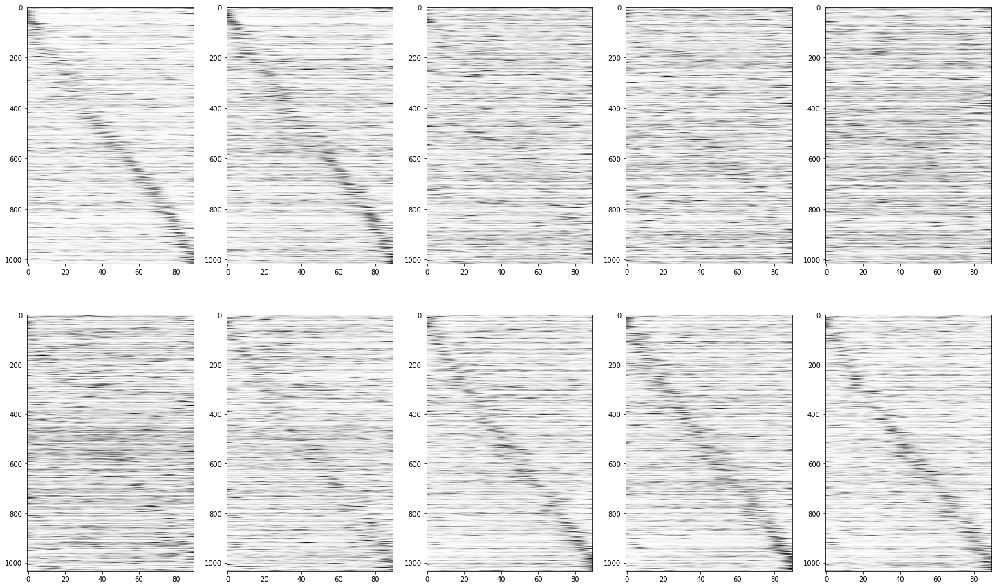

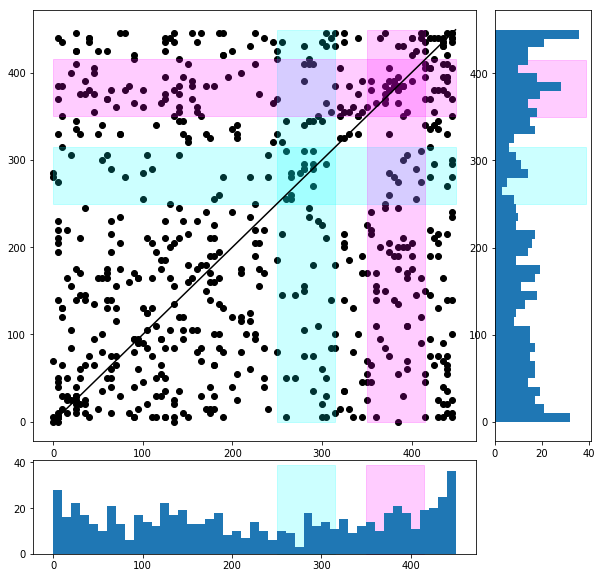

In [106]:
import PlaceCellAnalysis as pc
FR, masks, SI = pc.single_session(sess,savefigs=False,
                                deconv=True, win_trial_perm=True,
                                cell_method='s2p',method='bootstrap',morphlist=[0,.25,.5,.75,1])

num aberrant ttls 0.0
32038 (32038,) (32038, 21) 105022
frame diff 0
(1634, 90) (90, 1634)
(1634, 180) (90, 1634)
(1634, 270) (90, 1634)
(1634, 360) (90, 1634)


(array([[ 1.        ,  0.99747619,  0.97854913, ..., -0.01040557,
         -0.01155912, -0.01213059],
        [ 0.99747619,  1.        ,  0.99069535, ..., -0.00906986,
         -0.0102928 , -0.01089354],
        [ 0.97854913,  0.99069535,  1.        , ..., -0.00641733,
         -0.00774853, -0.00839272],
        ...,
        [-0.01040557, -0.00906986, -0.00641733, ...,  1.        ,
          0.99470681,  0.9876493 ],
        [-0.01155912, -0.0102928 , -0.00774853, ...,  0.99470681,
          1.        ,  0.99851525],
        [-0.01213059, -0.01089354, -0.00839272, ...,  0.9876493 ,
          0.99851525,  1.        ]]),
 array([[1.        , 0.68414142, 0.19722246, 0.16793954, 0.16284987],
        [0.68414142, 1.        , 0.45064038, 0.37193591, 0.36827844],
        [0.19722246, 0.45064038, 1.        , 0.78126133, 0.76493258],
        [0.16793954, 0.37193591, 0.78126133, 1.        , 0.8231207 ],
        [0.16284987, 0.36827844, 0.76493258, 0.8231207 , 1.        ]]),
 (<Figure size 720x72

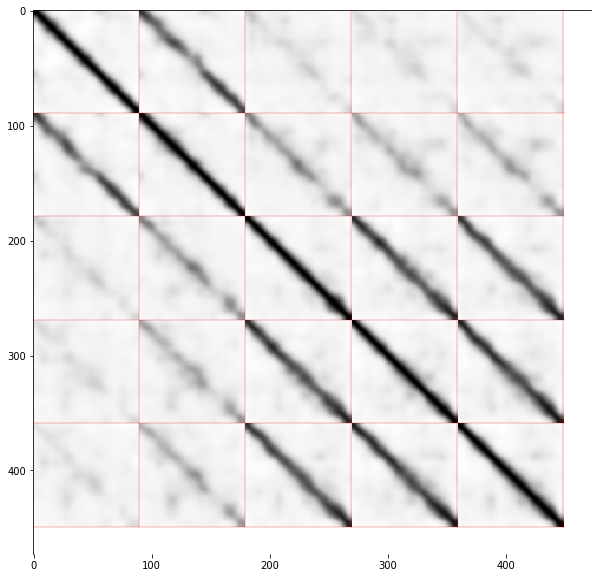

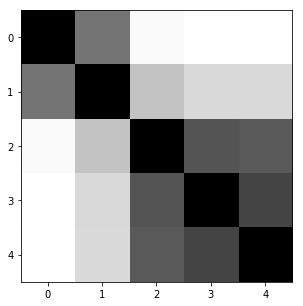

In [107]:
import SimilarityMatrixAnalysis as sm
sm.single_session(sess)

In [147]:
ORmask = np.array([masks[m] for m in masks.keys()]).sum(axis=0)>0

In [59]:
VRDat,C, S, A = pp.load_scan_sess(sess)



num aberrant ttls 0.0
32038 (32038,) (32038, 21) 105022


C:\Users\mplitt\Anaconda3\lib\site-packages\pandas\core\frame.py:4034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  downcast=downcast, **kwargs)


frame diff 0


In [60]:
trial_info, tstart_inds, teleport_inds = u.by_trial_info(VRDat)
lick_mat= u.make_pos_bin_trial_matrices(VRDat['lick']._values,
                                                            VRDat['pos']._values,
                                                            VRDat['tstart']._values,
                                                            VRDat['teleport']._values,
                                                            mat_only=True,bin_size=10)
speed_mat= u.make_pos_bin_trial_matrices(VRDat['speed']._values,
                                                            VRDat['pos']._values,
                                                            VRDat['tstart']._values,
                                                            VRDat['teleport']._values,
                                                            mat_only=True,bin_size=10)


In [61]:
S_trial_mat, occ_trial_mat, edges,centers = u.make_pos_bin_trial_matrices(S,VRDat['pos']._values,VRDat['tstart']._values,VRDat['teleport']._values,bin_size=10,speed=VRDat.speed._values)
S_trial_mat[np.isnan(S_trial_mat)]=0
S_trial_mat = sp.ndimage.filters.gaussian_filter1d(S_trial_mat,1,axis=1)

In [62]:
effMorph = trial_info['morphs'] +  trial_info['wallJitter'] + trial_info['bckgndJitter']
msort = np.argsort(effMorph)
reward_pos = trial_info['reward_pos']
reward_pos[np.isnan(reward_pos)]=480

In [63]:
print(speed_mat/np.nanmax(speed_mat.ravel()))

[[0.23873287 0.2691616  0.35326458 ... 0.42249741 0.38993867 0.33966927]
 [0.39656386 0.34848705 0.45108385 ... 0.51553484 0.50811558 0.51354501]
 [0.4942944  0.52171533 0.57065348 ... 0.53491313 0.50772501 0.48896168]
 ...
 [0.63276821 0.68241898 0.72402058 ... 0.7695505  0.73150791 0.71255611]
 [0.63954233 0.67229286 0.70755392 ... 0.84038001 0.81239006 0.79149548]
 [0.60734507 0.64373094 0.6862825  ... 0.58591957 0.50262254 0.38063551]]


(<Figure size 1080x1080 with 3 Axes>,
  <matplotlib.axes._subplots.AxesSubplot at 0x1a80476b5f8>])

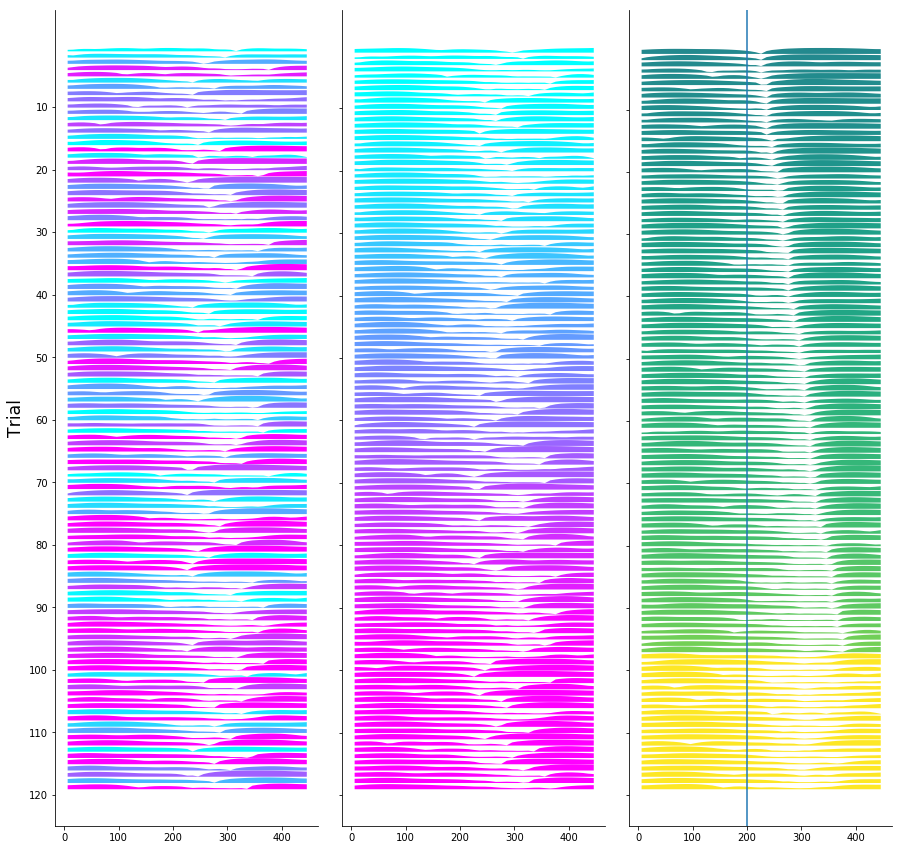

In [64]:
b.behavior_raster_foraging(speed_mat/np.nanmax(speed_mat.ravel()),centers,effMorph,reward_pos/480,smooth=False, max_pos=None)

(<Figure size 1080x1080 with 3 Axes>,
  <matplotlib.axes._subplots.AxesSubplot at 0x1a8052bce80>])

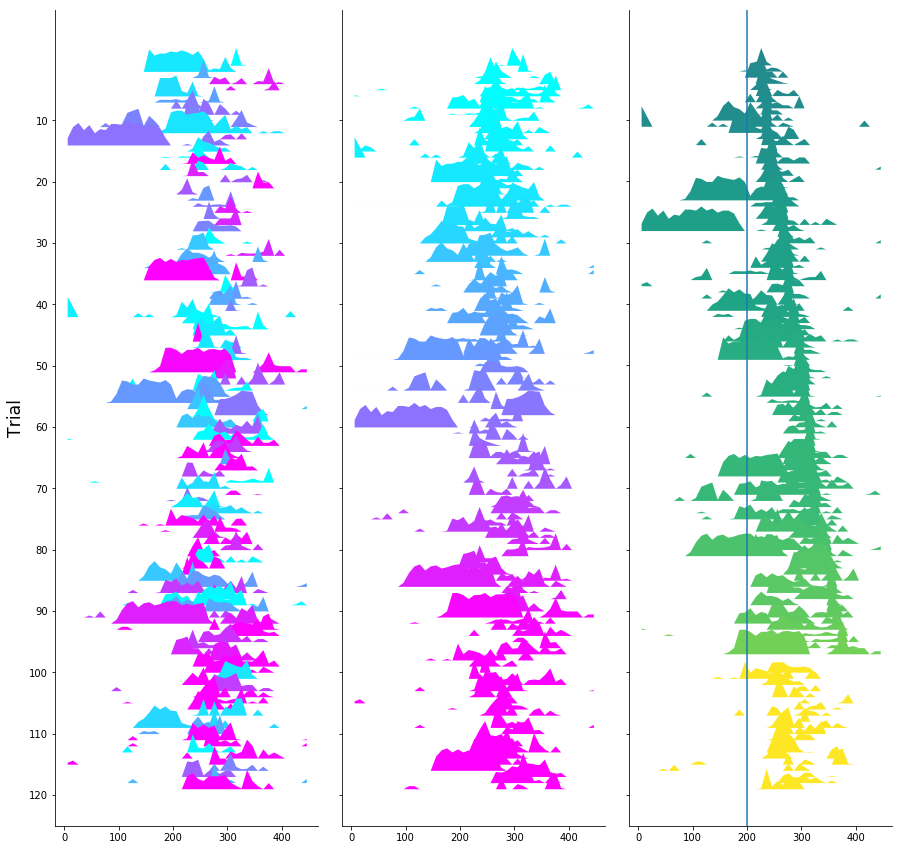

In [65]:
b.behavior_raster_foraging(lick_mat,centers,effMorph,reward_pos/480,smooth=False, max_pos=None)

In [66]:
# S_pc = S_trial_mat[:,:,ORmask]
S_pc = S_trial_mat[:,:,:]
# nanmask = 1-np.isnan(S_pc)

In [67]:
# S_tmat = sp.stats.zscore(np.reshape(S_pc,[S_trial_mat.shape[0],-1]),axis=-1)
S_tmat = np.reshape(S_pc,[S_trial_mat.shape[0],-1])
S_tmat = S_tmat/np.linalg.norm(S_tmat,ord=2,axis=-1)[:,np.newaxis]
# nanmask = np.reshape(nanmask,[S_trial_mat.shape[0],-1])

In [68]:
S_t_rmat = np.matmul(S_tmat,S_tmat.T) #/np.matmul(nanmask,nanmask.T)

In [69]:
print(S_t_rmat.shape)
print(S_t_rmat)

(120, 120)
[[1.         0.15450711 0.14914771 ... 0.16047813 0.17113498 0.16366074]
 [0.15450711 1.         0.19129135 ... 0.21363174 0.19345862 0.21398734]
 [0.14914771 0.19129135 1.         ... 0.21791016 0.2079818  0.19303871]
 ...
 [0.16047813 0.21363174 0.21791016 ... 1.         0.20733532 0.33853333]
 [0.17113498 0.19345862 0.2079818  ... 0.20733532 1.         0.20064209]
 [0.16366074 0.21398734 0.19303871 ... 0.33853333 0.20064209 1.        ]]


In [70]:
import sklearn as sk
import sklearn.cluster as clust


In [83]:
score = []
for c in range(2,10):
    spectclust = clust.SpectralClustering(n_clusters=c,affinity='precomputed')
    labels = spectclust.fit_predict(S_t_rmat)
    
    
#     aggclust = clust.AgglomerativeClustering(n_clusters=c,affinity='cosine',linkage="average")
#     aggclust.fit(S_tmat)
#     s=sk.metrics.silhouette_score(S_tmat,aggclust.labels_,metric='cosine')
    s=sk.metrics.silhouette_score(S_tmat,labels,metric='cosine')
#     s=sk.metrics.silhouette_score(1-S_t_rmat,labels,metric='precomputed')
    
    score.append(np.round(100.*s))
    print(s*100.)
    

c = np.argmax(score)+2


# aggclust = clust.AgglomerativeClustering(n_clusters=c,affinity='cosine',linkage="average")
# aggclust.fit(S_tmat)
spectclust = clust.SpectralClustering(n_clusters=c,affinity='precomputed')
spectclust.fit(S_t_rmat)

12.942758348123599
11.448427523338266
9.71694015586111
6.865604928647465
6.069203933675083
6.2468249071189925
6.339159649598182
6.590677501605106


SpectralClustering(affinity='precomputed', assign_labels='kmeans', coef0=1,
          degree=3, eigen_solver=None, eigen_tol=0.0, gamma=1.0,
          kernel_params=None, n_clusters=2, n_init=10, n_jobs=None,
          n_neighbors=10, random_state=None)

2


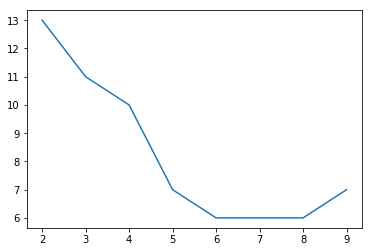

In [72]:
f,ax= plt.subplots()
ax.plot(np.arange(2,10),score)
print(c)

In [73]:
# clustsort = np.argsort(aggclust.labels_)
# clustsort = np.argsort(spectclust.labels_)

# sort clusters by average morph values 
clustmean = np.array([effMorph[spectclust.labels_==i].mean() for i in range(c)])
clusterOrder = np.argsort(clustmean)
labels = np.zeros(effMorph.shape)

for i,cl in enumerate(clusterOrder.tolist()):
    labels[spectclust.labels_==cl]=i
    
clustsort = np.argsort(labels)  


[]

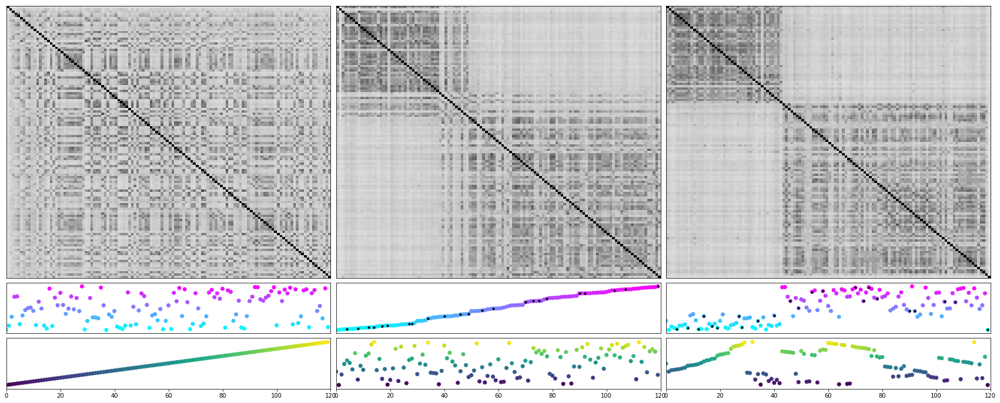

In [74]:
import matplotlib.gridspec as gridspec
f = plt.figure(figsize=[30,12])
gs = gridspec.GridSpec(14,30)
x=np.arange(effMorph.size)
rmask = trial_info['rewards']==0
tnumber = np.arange(x.shape[0])/x.shape[0]
vmax = .7
# f,ax = plt.subplots(2,3,figsize=[20,10],sharex=True)
ax = f.add_subplot(gs[:10,:10])
ax.imshow(S_t_rmat,cmap='Greys',vmin=0,vmax=vmax,aspect='auto')
ax.set_yticks([])
ax.set_xticks([])
ax = f.add_subplot(gs[10:12,:10])
ax.scatter(x,effMorph,c=effMorph,cmap='cool')
ax.set_xlim([0,x.shape[0]])
ax.set_yticks([])
ax.set_xticks([])
ax = f.add_subplot(gs[12:,:10])
ax.scatter(x,tnumber,c=tnumber,cmap='viridis')
ax.set_xlim([0,x.shape[0]])
ax.set_yticks([])
# ax[0,0].imshow(S_t_rmat,cmap='Greys',vmin=0,vmax=.5,aspect='auto')
S_agg_sort = S_t_rmat[clustsort,:]
S_agg_sort = S_agg_sort[:,clustsort]
S_rmat_sort = S_t_rmat[msort,:]
S_rmat_sort = S_rmat_sort[:,msort]


ax = f.add_subplot(gs[:10,10:20])
ax.imshow(S_rmat_sort,cmap='Greys',vmin=0,vmax=vmax,aspect='auto')
ax.set_yticks([])
ax.set_xticks([])
ax = f.add_subplot(gs[10:12,10:20])
ax.scatter(x,effMorph[msort],c=effMorph[msort],cmap='cool')
ax.scatter(x[rmask],effMorph[msort[rmask]],c='black',s=10)
ax.set_xlim([0,x.shape[0]])
ax.set_yticks([])
ax.set_xticks([])
ax = f.add_subplot(gs[12:,10:20])
ax.scatter(x,tnumber[msort],c=tnumber[msort],cmap='viridis')
ax.set_xlim([0,x.shape[0]])
ax.set_yticks([])


ax = f.add_subplot(gs[:10,20:])
ax.imshow(S_agg_sort,cmap='Greys',vmin=0,vmax=vmax,aspect='auto')
ax.set_yticks([])
ax.set_xticks([])
ax = f.add_subplot(gs[10:12,20:])
ax.scatter(x,effMorph[clustsort],c=effMorph[clustsort],cmap='cool')
ax.set_yticks([])
ax.set_xticks([])
# tmpeff = np.copy(effMorph[1:])
# ax.scatter(x[:-1],tmpeff[clustsort[1:]],c=tmpeff[clustsort[1:]],cmap='cool')
ax.scatter(x[rmask],effMorph[clustsort[rmask]],c='black',s=10)
ax.set_xlim([0,x.shape[0]])
ax = f.add_subplot(gs[12:,20:])
ax.scatter(x,tnumber[clustsort],c=tnumber[clustsort],cmap='viridis')
ax.set_xlim([0,x.shape[0]])
ax.set_yticks([])


12.942758348123586
11.448427523338257
9.716940155861105
6.865604928647458
6.069203933675081
6.246824907118988
6.280886753585674
6.75209868032954


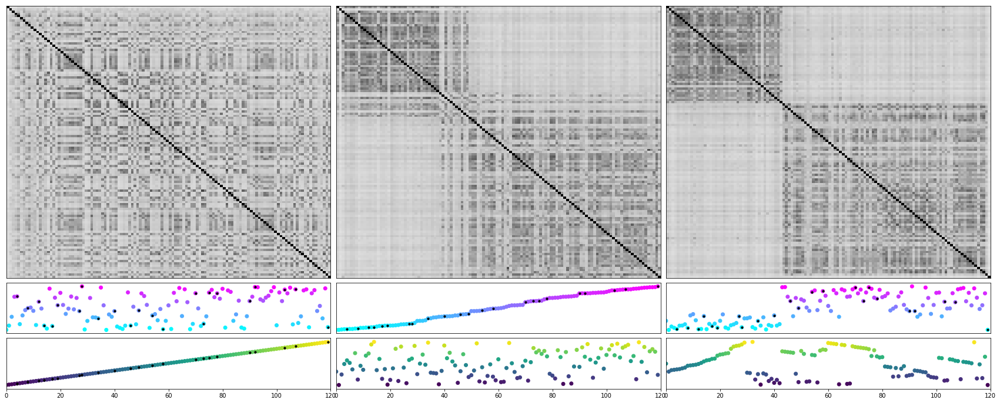

In [84]:
f,axtup = sm.plot_trial_simmat(S_t_rmat,trial_info,vmax=.7)

In [85]:
lem = sk.manifold.SpectralEmbedding(affinity='precomputed',n_components=3)


In [86]:
X = lem.fit_transform(S_t_rmat)

In [87]:
# lem = sk.manifold.MDS(dissimilarity='precomputed')
# X = lem.fit_transform(1-S_t_rmat)

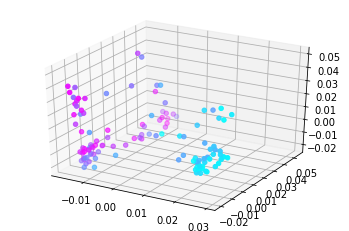

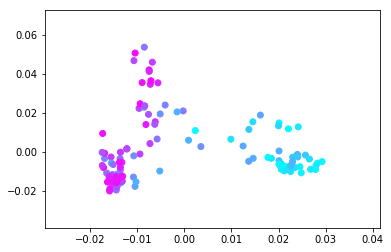

In [88]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:,0],X[:,1],X[:,2],c=effMorph,cmap='cool')

f,ax = plt.subplots()
ax.scatter(X[:,0],X[:,1],c=effMorph,cmap='cool')



In [168]:
print(SI.keys())
SI_total = [SI[m]['all'] for m in [0,.25,.5,.75,1]]
SIt = SI_total[0]
for ind in SI_total[1:]:
    SIt+=ind

order = np.argsort(SIt)[::-1]

dict_keys([0, 0.25, 0.5, 0.75, 1])


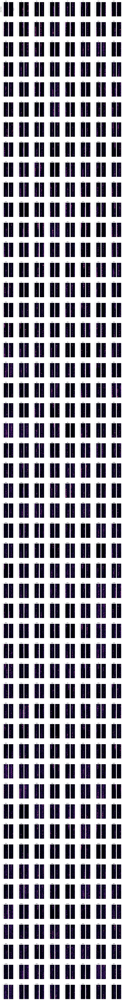

In [122]:
f= pc.plot_top_cells(S_trial_mat,masks,SI,effMorph)

In [123]:
f.savefig('test.pdf',format='pdf')

C:\Users\mplitt\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


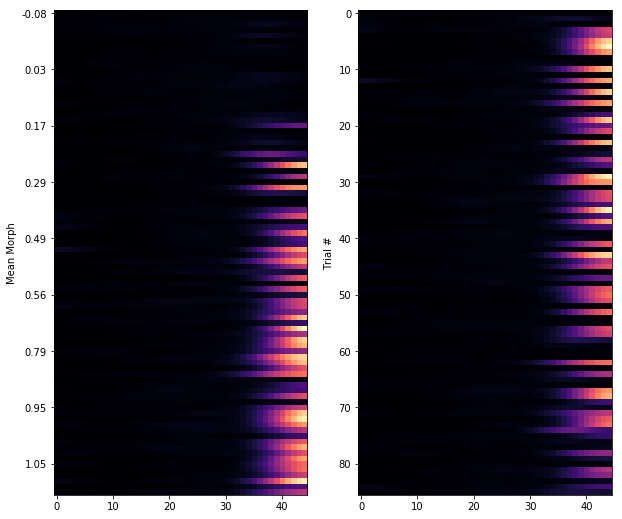

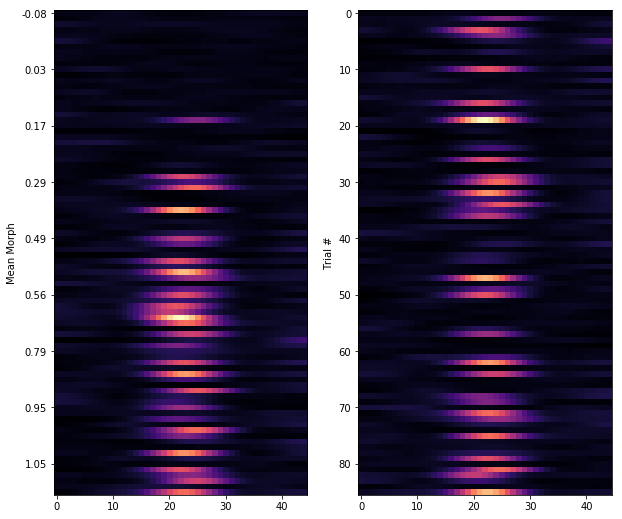

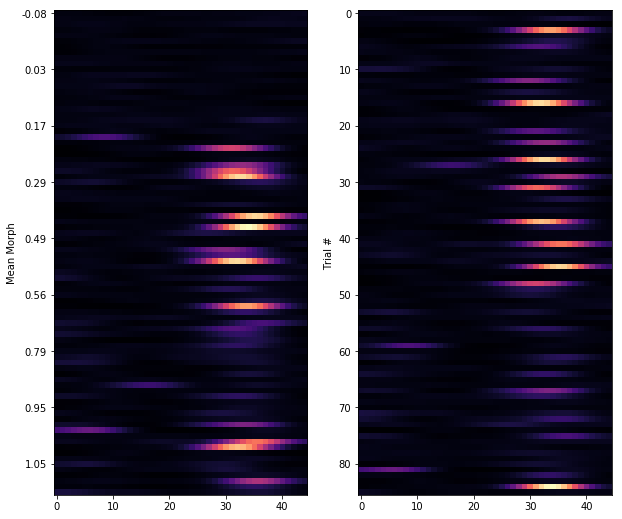

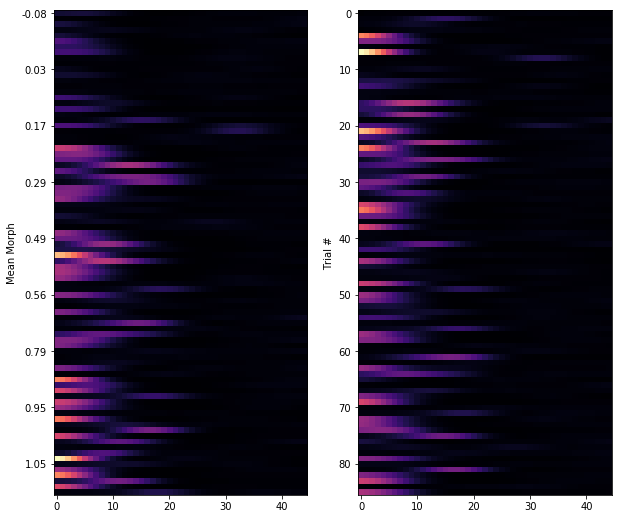

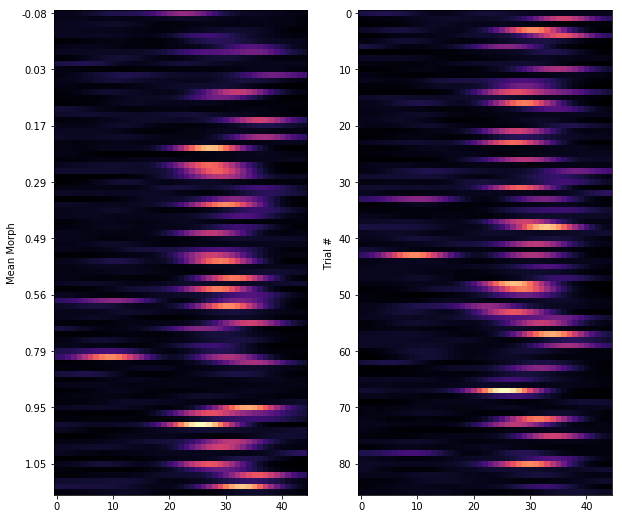

...

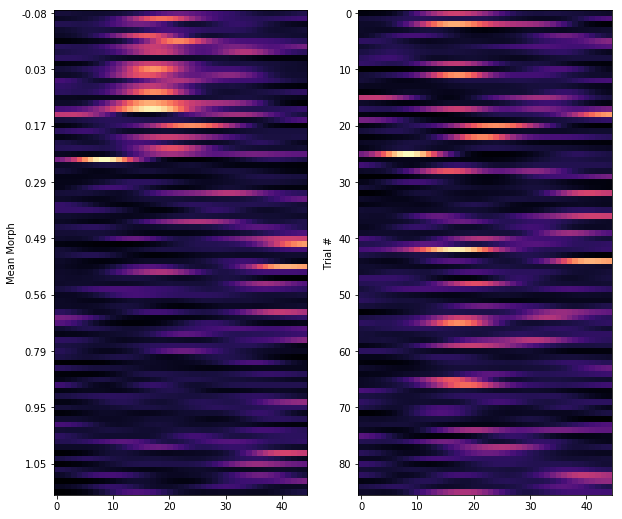

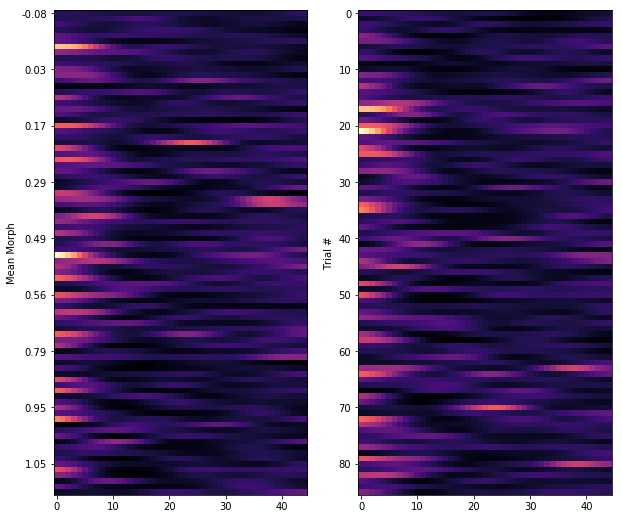

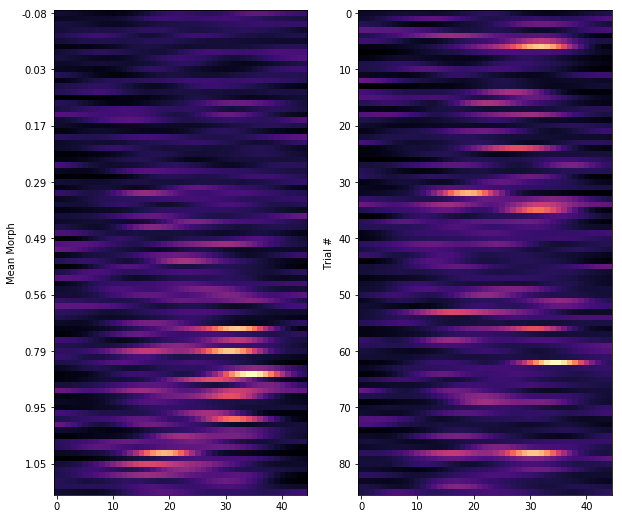

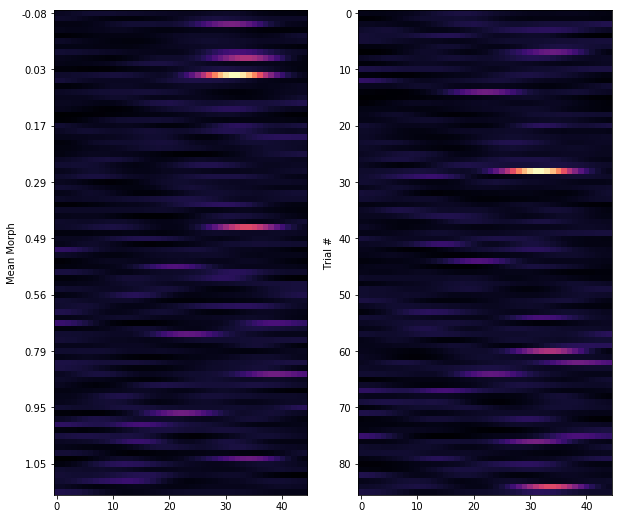

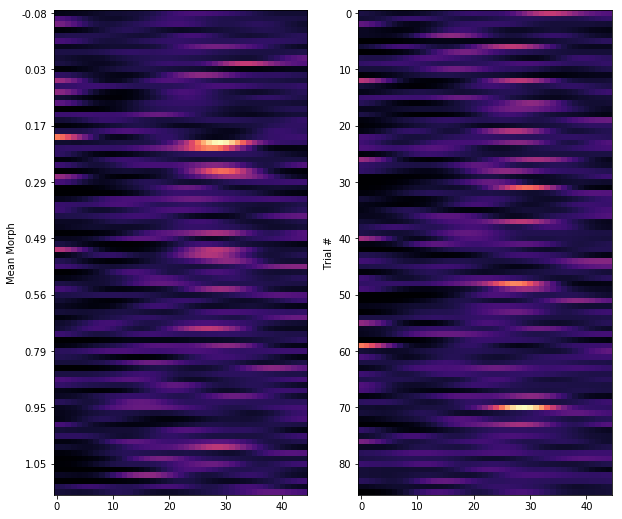

In [169]:
from scipy.ndimage import filters
effMorph_s = effMorph[msort]
for i,o in enumerate(order[:100].tolist()):
    f,ax = plt.subplots(1,2,figsize=(10,10))
    S_i = np.copy(S_trial_mat[:,:,o])
    nan_inds = np.isnan(S_i)
    S_i_nanless = np.copy(S_i)
    S_i_nanless[nan_inds]=0
    One = np.ones(S_i.shape)
    One[nan_inds]=.001
    S_i_nanless= filters.gaussian_filter(S_i_nanless,[0,3])
    One = filters.gaussian_filter(One,[0,3])
    S_i = S_i_nanless/One
    S_i[nan_inds]=np.nan
    S_i/=np.nanmean(S_i.ravel())
    ax[0].imshow(S_i[msort,:],cmap='magma') 
    ax[1].imshow(S_i,cmap='magma') 
    tick_inds = np.arange(0,S_i.shape[0],10)
    ax[0].set_yticks(tick_inds)
    tick_labels = ["%.2f" % effMorph_s[i] for i in tick_inds]
    ax[0].set_yticklabels(tick_labels)
    ax[0].set_ylabel('Mean Morph')
    ax[1].set_ylabel('Trial #')


In [170]:
from sklearn.decomposition import PCA

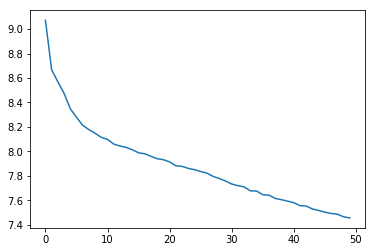

In [171]:
pca = PCA()
trialmask = (VRDat['pos']>0) & (VRDat['morph']==0)
S[np.isnan(S)]=0
S_sm = sp.ndimage.filters.gaussian_filter1d(S,5,axis=0)
X = pca.fit_transform(S_sm[trialmask,:])
f,ax = plt.subplots()
# ax.plot(np.cumsum(pca.explained_variance_ratio_)[:50])
ax.plot(np.log(pca.singular_values_)[:50])

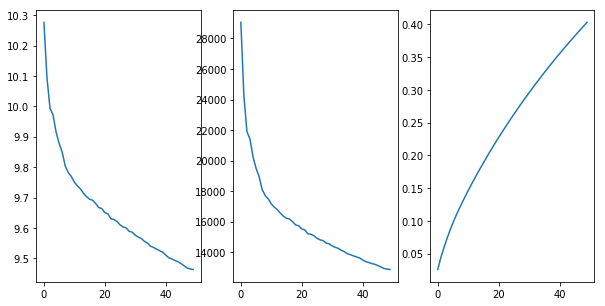

In [262]:
f,ax = plt.subplots(1,3,figsize=[10,5])
# ax.plot(np.cumsum(pca.explained_variance_ratio_)[:50])
ax[0].plot(np.log(pca.singular_values_)[:50])
ax[1].plot(pca.singular_values_[:50])
ax[2].plot(np.cumsum(pca.explained_variance_ratio_[:50]))

In [ ]:
# choosing 20 because it seems to get past the "kink" in singular value plots


In [501]:
S[np.isnan(S)]=0
S_sm = sp.ndimage.filters.gaussian_filter1d(S,5,axis=0)

In [502]:
S_sm_n = S_sm/(np.linalg.norm(S_sm,ord=2,axis=1)[:,np.newaxis]+.001)

In [503]:
print(S_sm_n.shape)

(37344, 1951)


In [504]:
S_cos = np.matmul(S_sm_n,S_sm_n.T)

In [505]:
print(S_cos.shape)

(37344, 37344)


In [506]:
lem = sk.manifold.SpectralEmbedding(affinity='precomputed',n_components=5)
X = lem.fit_transform(S_cos+.0001)


In [507]:
print(X.shape)

(37344, 5)


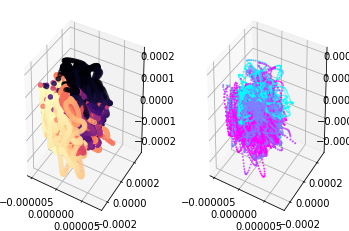

In [508]:

from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
p_ax = fig.add_subplot(121, projection='3d')
mask = (VRDat['pos']._values>0) & (VRDat['morph']._values>=0)
p_ax.scatter(X[mask,0],X[mask,1],X[mask,2],c=VRDat['pos']._values[mask],cmap='magma')
m_ax = fig.add_subplot(122, projection='3d')
m_ax.scatter(X[mask,0],X[mask,1],X[mask,2],c=VRDat['morph']._values[mask],s=1,cmap='cool')
#m_ax.view_init(20,0)


num aberrant ttls 0.0
32038 (32038,) (32038, 21) 105022


C:\Users\mplitt\Anaconda3\lib\site-packages\pandas\core\frame.py:4034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  downcast=downcast, **kwargs)


frame diff 0
(32038, 1634)
start bootstrap
end bootstrap


C:\Users\mplitt\MightyMorphingPhotonRangers\utilities.py:107: RuntimeWarning: Mean of empty slice
  frmap[i] = np.nanmean(C[(position>edge1) & (position<=edge2),:],axis=0)


start bootstrap
end bootstrap
start bootstrap
end bootstrap
start bootstrap
end bootstrap
start bootstrap
end bootstrap
morph 0 place cells = 876 out of 1634 , 0.536108 
morph 1 place cells = 895 out of 1634, 0.547736
(1634, 45) (45, 1634)
(1634, 90) (45, 1634)
(1634, 135) (45, 1634)
(1634, 180) (45, 1634)
12.949387554428728
11.456266744228195
9.611372668587169
6.861230102187968
6.0663020881172125
6.246827607708332
6.2801222887674
6.766241820259637
failed to make path G:\My Drive\Figures\TwoTower\SingleSession\4139265.3\TwoTower_foraging_24_02_2019_2


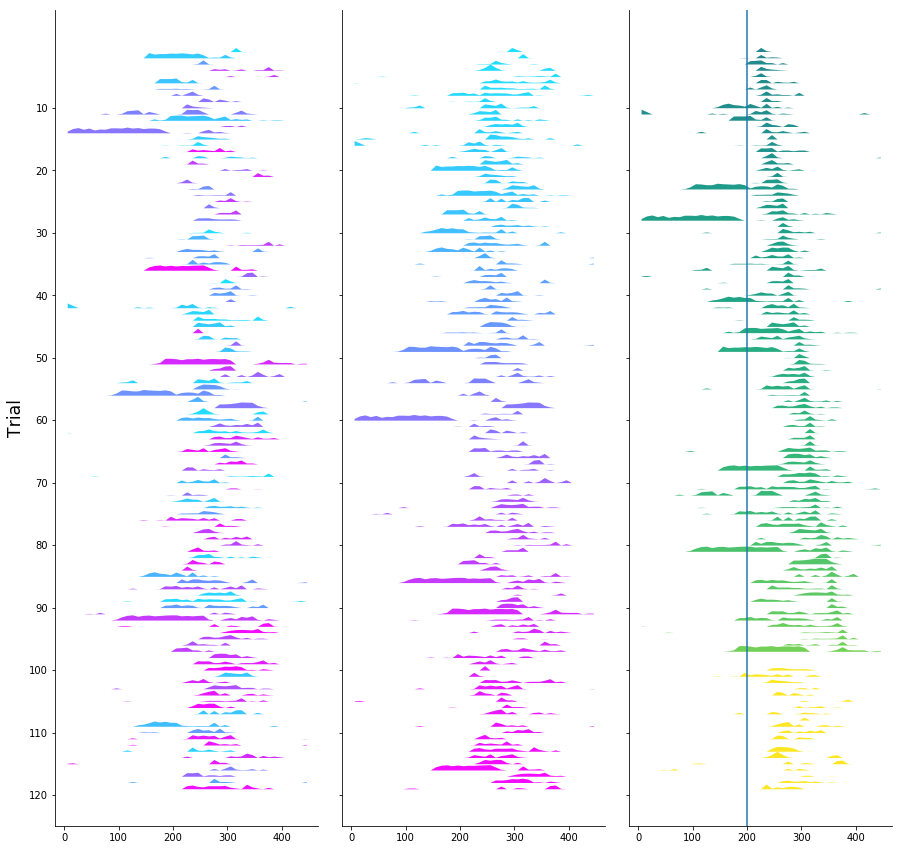

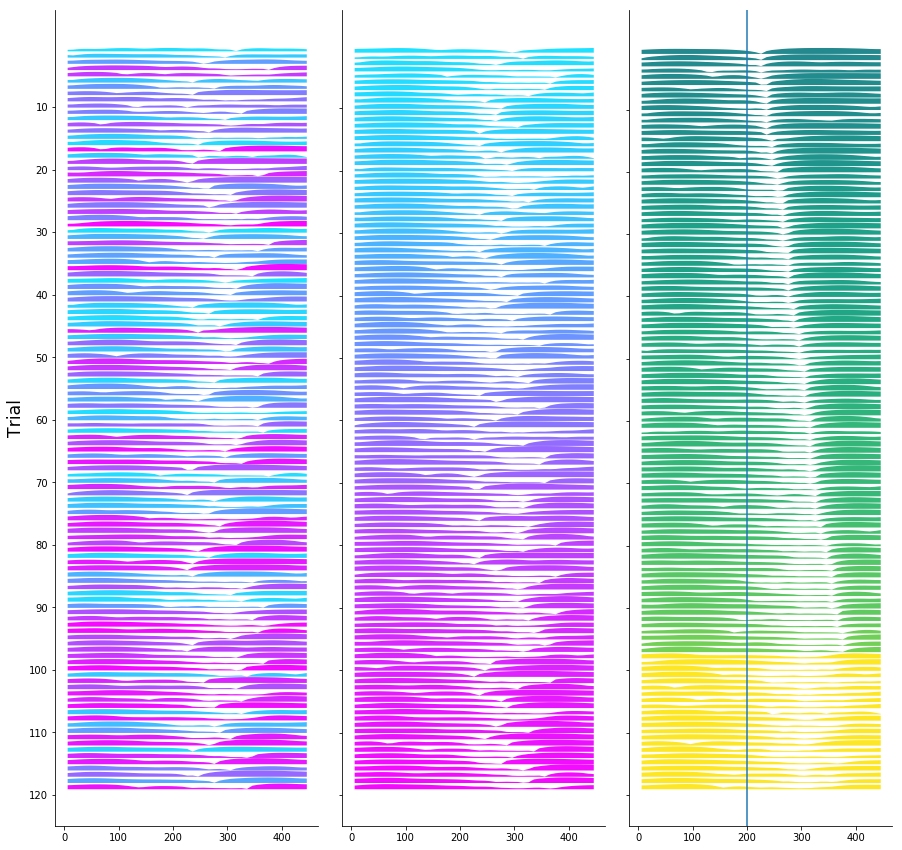

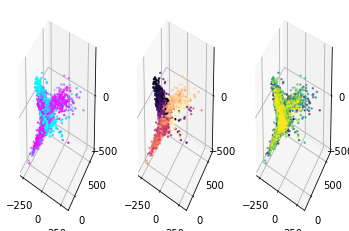

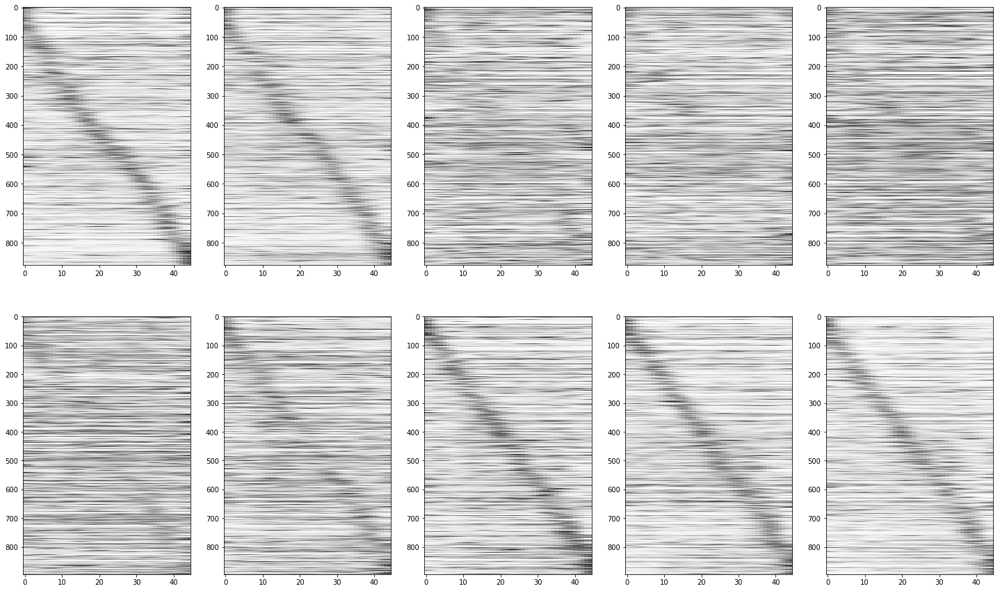

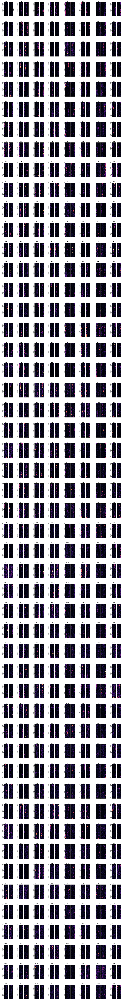

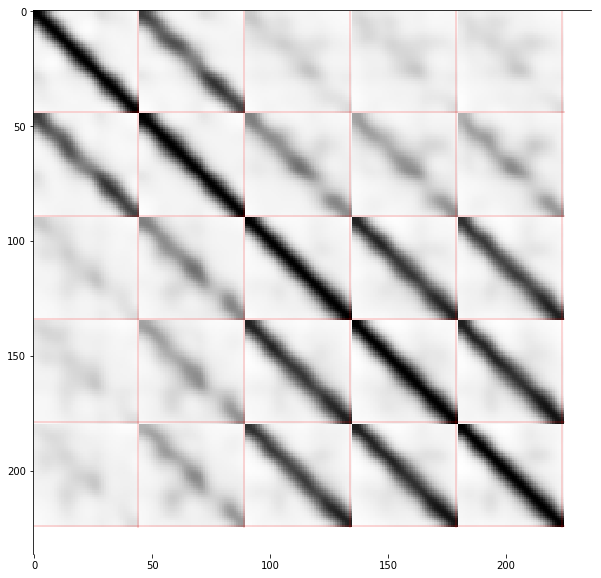

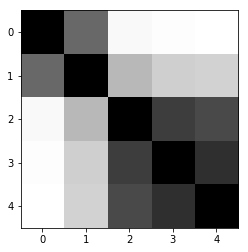

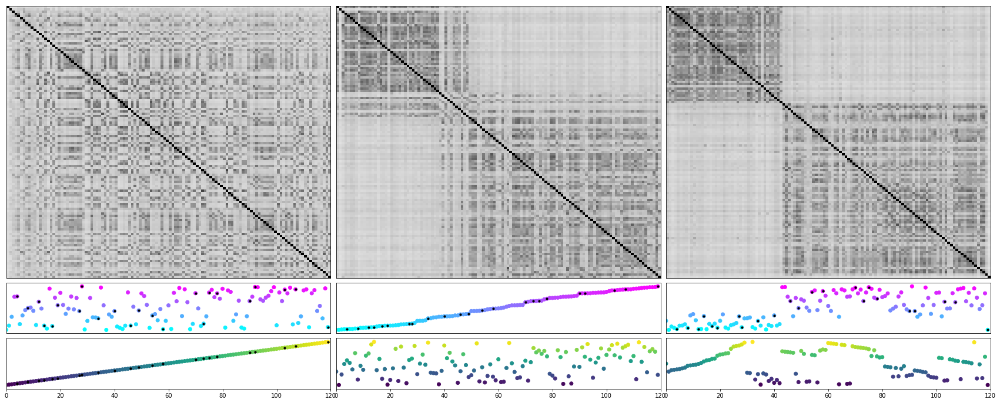

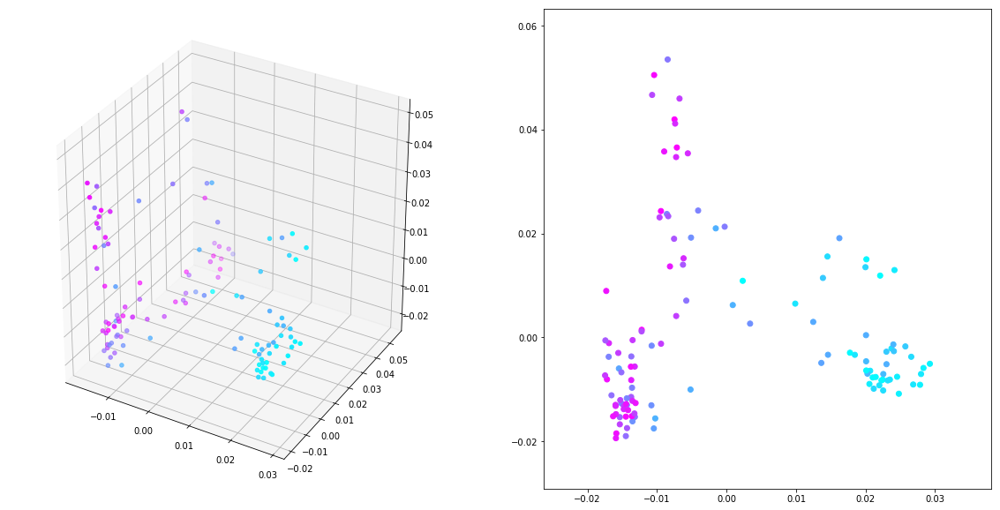

In [124]:
from single_session_plots import single_session_figs
single_session_figs(sess)